In [1]:
import cv2
import os
import matplotlib.pyplot as plt
from glob import glob

from src.image_processor import ImageProcessor

# Roteiro I

In [3]:
train_directory = 'data/bracs-binary/train'
test_directory = 'data/bracs-binary/test'

train_processor = ImageProcessor(train_directory)
test_processor = ImageProcessor(test_directory)

processors = []
processors.append(train_processor)
processors.append(test_processor)

for processor in processors:
    processor.load_images()

Aplique a equalização de histograma nas imagens do dataset original (treino e teste). Em seguida, salve os resultados dos novos datasets;

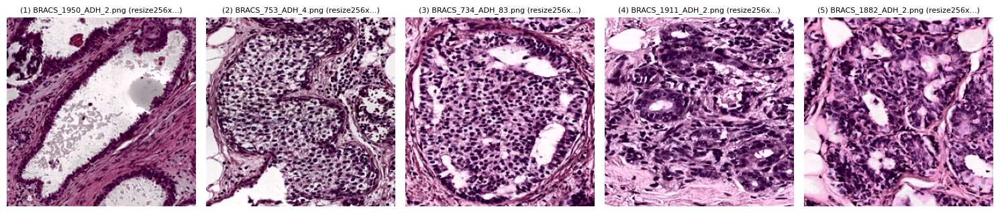

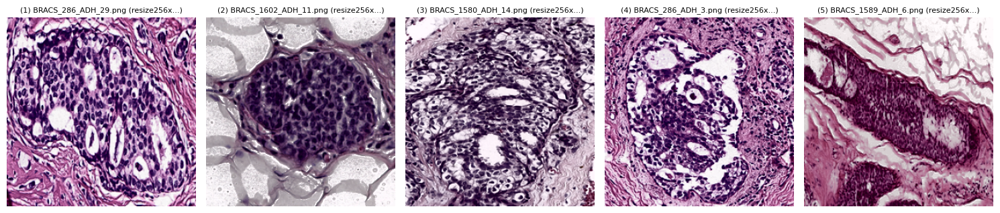

In [10]:
for processor in processors:
    processor.resize_images()
    processor.equalize_histogram()
    processor.show_sample_images(num_images=5)
    processor.save_images()
    processor.reset_images()

Aplique correção gamma nas imagens do dataset original (treino e teste), utilizando três diferentes valores de gamma (ajuste os parâmetros a seu critério). Em seguida, salve os resultados dos novos datasets;

In [11]:
gamma_values = [0.5, 1.5, 2.0]

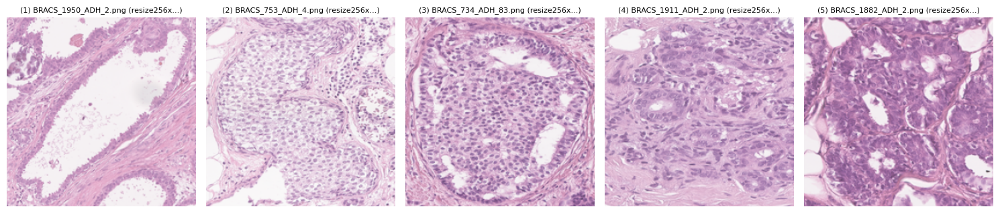

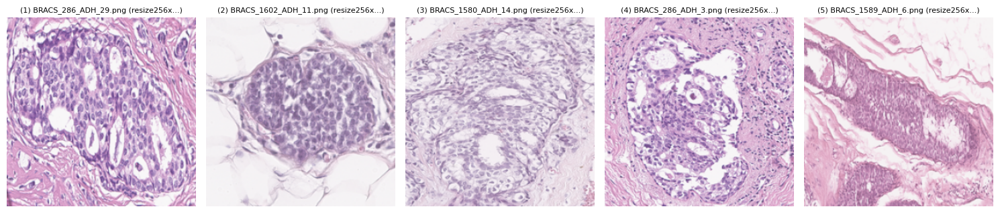

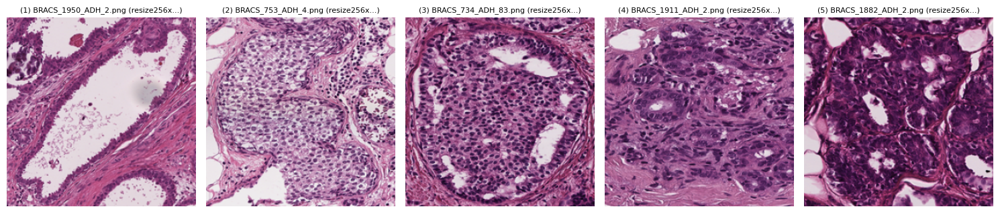

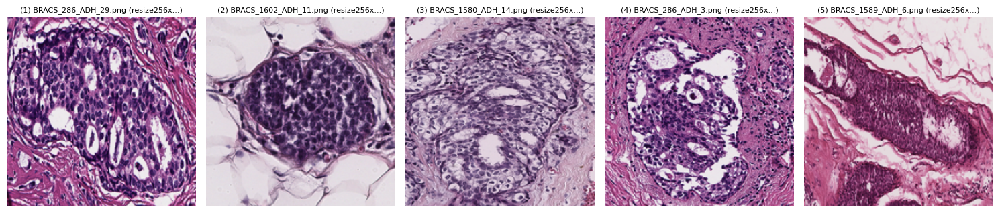

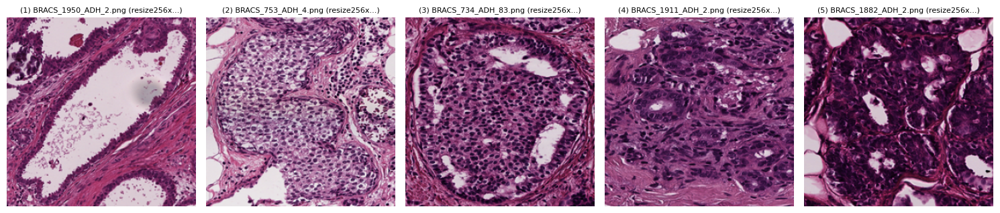

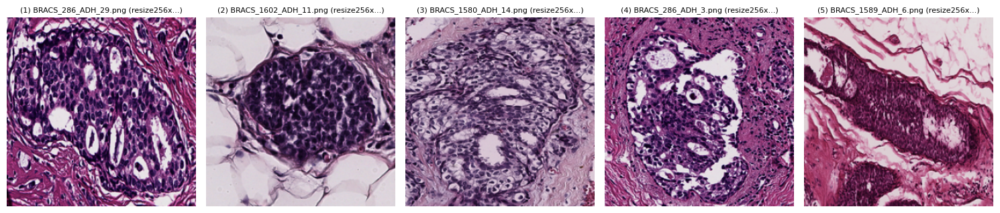

In [12]:
for gamma in gamma_values:
    for processor in processors:
        processor.resize_images()
        processor.gamma_correction(gamma)
        processor.show_sample_images(num_images=5)
        processor.save_images()
        processor.reset_images()

Suavize as imagens do dataset original(treino e teste) aplicando o filtro gaussiano (ajuste os parâmetros a seu critério). Em seguida, salve os resultados do novo dataset;

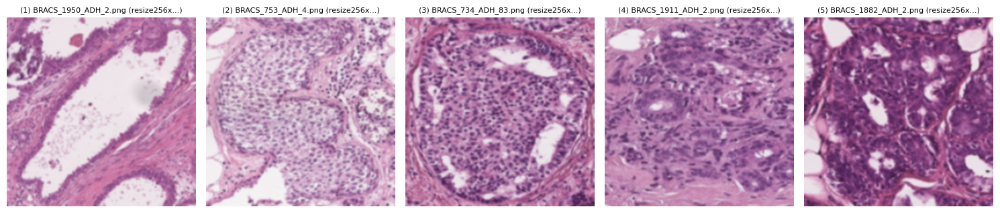

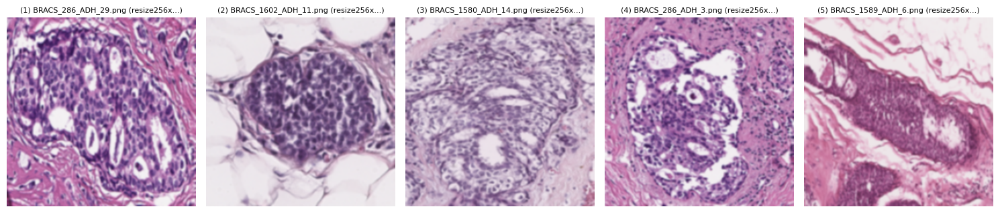

In [13]:
for processor in processors:
    processor.resize_images()
    processor.gaussian_smoothing(kernel_size=(5, 5))  # Ajustar parâmetros conforme necessário
    processor.show_sample_images(num_images=5)
    processor.save_images()
    processor.reset_images()

Realize o aguçamento das imagens do dataset original (treino e teste) aplicando o filtro laplace (ajuste os parâmetros a seu critério). Em seguida, salve os resultados do novo dataset.

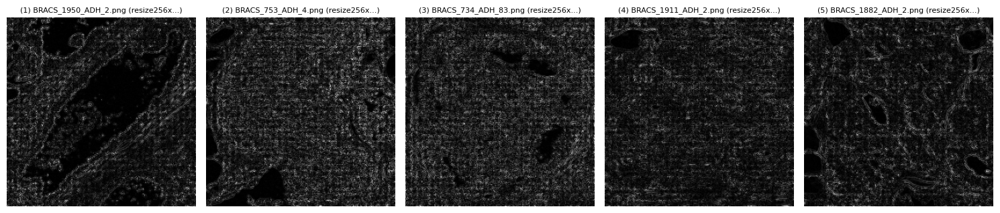

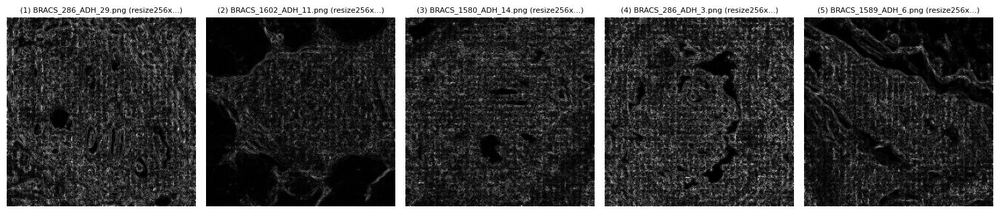

In [14]:
for processor in processors:
    processor.resize_images()
    processor.laplacian_sharpening() 
    processor.show_sample_images(num_images=5)
    processor.save_images()
    processor.reset_images()

# Roteiro II

Implemente as transformações de cor do cabeçalho da Figura 2.5, utilizando 3 imagens do dataset original 1 . Além disso, realize a extração das seguintes features:

(a) Histograma RGB

(b) O1 , O2

(c) Transformada de Cor

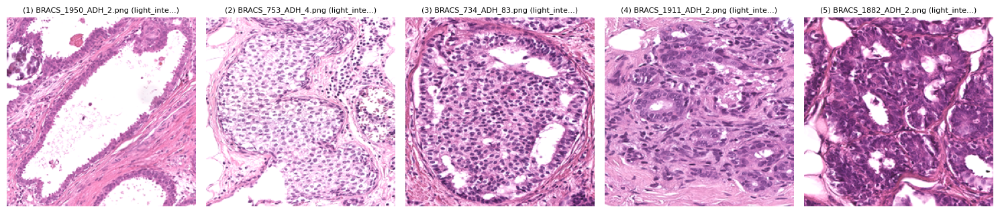

In [8]:
train_processor.light_intensity_change(a=1.2) 
train_processor.show_sample_images(num_images=5)
train_processor.save_images()
processor.reset_images()

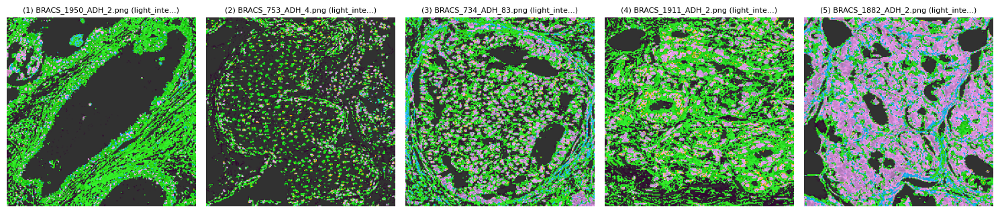

In [10]:
train_processor.light_intensity_shift(o1=50) 
train_processor.show_sample_images(num_images=5)
train_processor.save_images()
train_processor.reset_images()

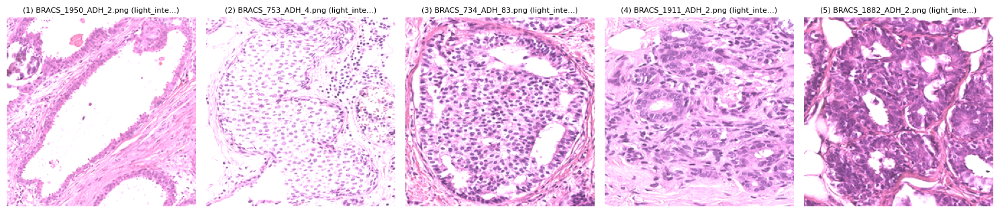

In [9]:
train_processor.light_intensity_change_and_shift(a=1.1, o1=30) 
train_processor.show_sample_images(num_images=5)
train_processor.save_images()

Além disso, realize a extração das seguintes features:

In [ ]:
rgb_histogram_features = processor.extract_rgb_histogram()
o1_o2_features = processor.extract_o1_o2()
color_transform_features = processor.extract_color_transform()

# Montando Figuras:

In [2]:
def plot_images(imagens):
    fig, axes = plt.subplots(3, 3, figsize=(12, 12))

    for i, (image_name, image_array) in enumerate(imagens.items()):
        row, col = divmod(i, 3)
        axes[row, col].imshow(image_array, cmap='gray')  
        title = f"({i+1}) {image_name}"
        if len(title) > 40:
            title = title[:40] + '...'
        axes[row, col].set_title(title)  
        axes[row, col].axis('off')  

    plt.tight_layout()
    plt.show()

In [3]:
amostras = 'data/bracs-binary/amostras'
amostras_processor = ImageProcessor(amostras)
amostras_processor.load_images()
amostras = {}


In [4]:
amostras = amostras_processor.get_images()

amostras_processor.convert_to_grayscale()
amostras.update(amostras_processor.get_images())

amostras_processor.equalize_histogram()
amostras.update(amostras_processor.get_images())

amostras_processor.reset_images()

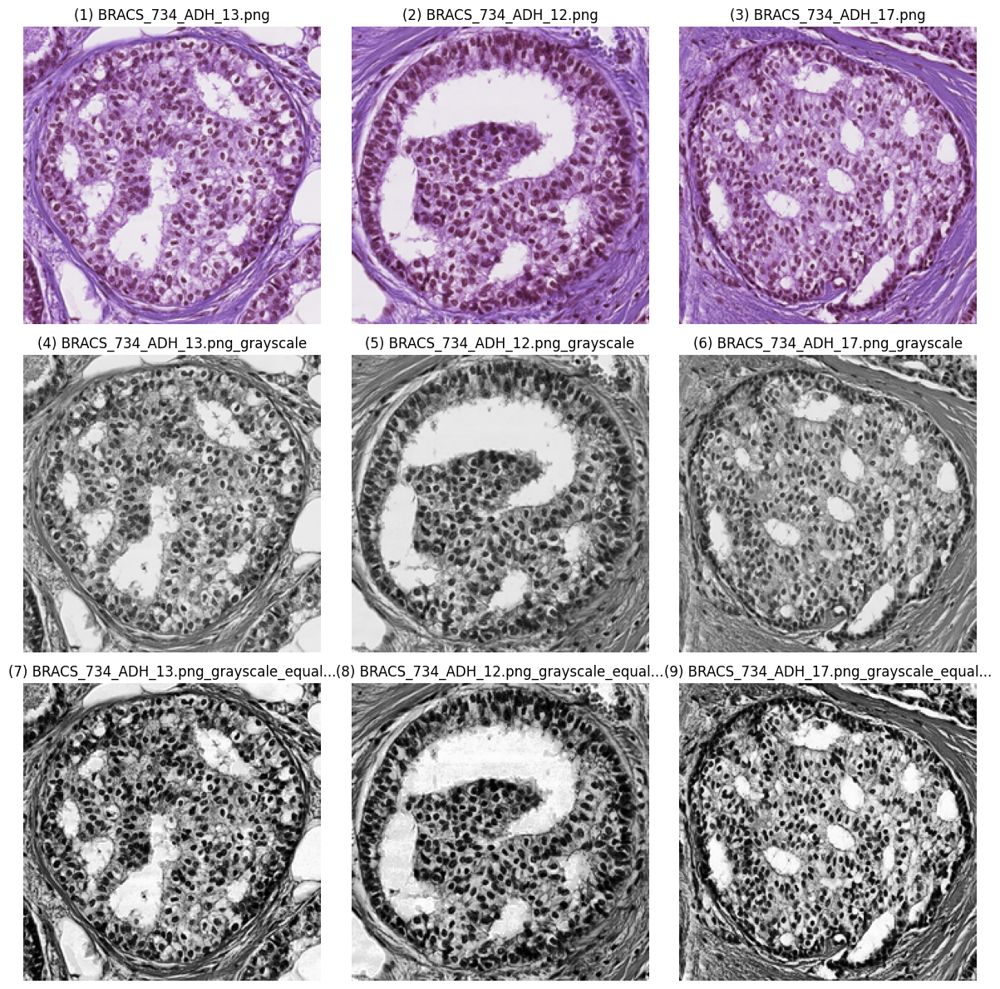

In [5]:
plot_images(amostras)

In [6]:
amostras = amostras_processor.get_images()

amostras_processor.convert_to_grayscale()
amostras.update(amostras_processor.get_images())

amostras_processor.laplacian_sharpening()
amostras.update(amostras_processor.get_images())

amostras_processor.reset_images()

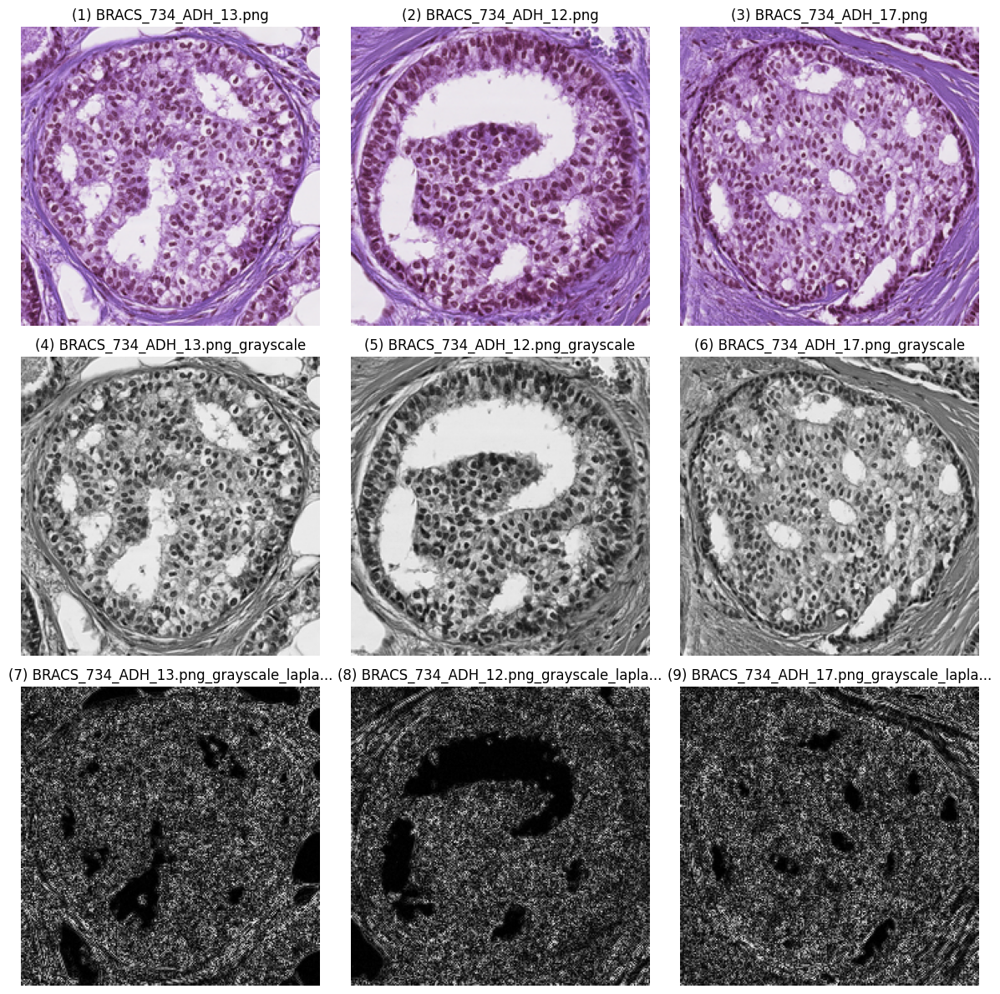

In [7]:
plot_images(amostras)

In [8]:
amostras = {}

amostras_processor.convert_to_grayscale()
amostras_processor.gaussian_smoothing(sigma=4)
amostras.update(amostras_processor.get_images())
amostras_processor.reset_images()

amostras_processor.convert_to_grayscale()
amostras_processor.gaussian_smoothing(sigma=16)
amostras.update(amostras_processor.get_images())
amostras_processor.reset_images()

amostras_processor.convert_to_grayscale()
amostras_processor.gaussian_smoothing(sigma=32)
amostras.update(amostras_processor.get_images())
amostras_processor.reset_images()

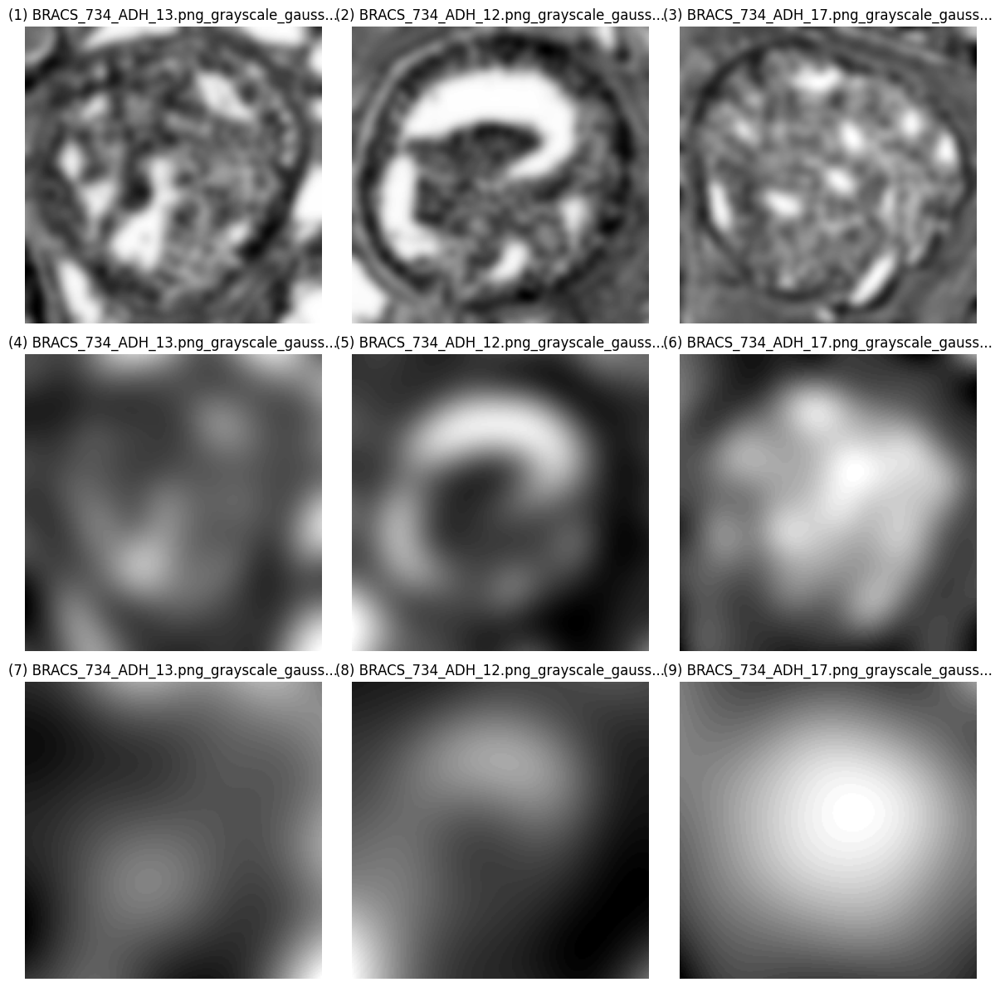

In [10]:
plot_images(amostras)

In [7]:
amostras = {}

amostras_processor.convert_to_grayscale()
amostras.update(amostras_processor.get_images())
amostras_processor.reset_images()

amostras_processor.convert_to_grayscale()
amostras_processor.gamma_correction(0.5)
amostras.update(amostras_processor.get_images())
amostras_processor.reset_images()

amostras_processor.convert_to_grayscale()
amostras_processor.gamma_correction(1.5)
amostras.update(amostras_processor.get_images())
amostras_processor.reset_images()

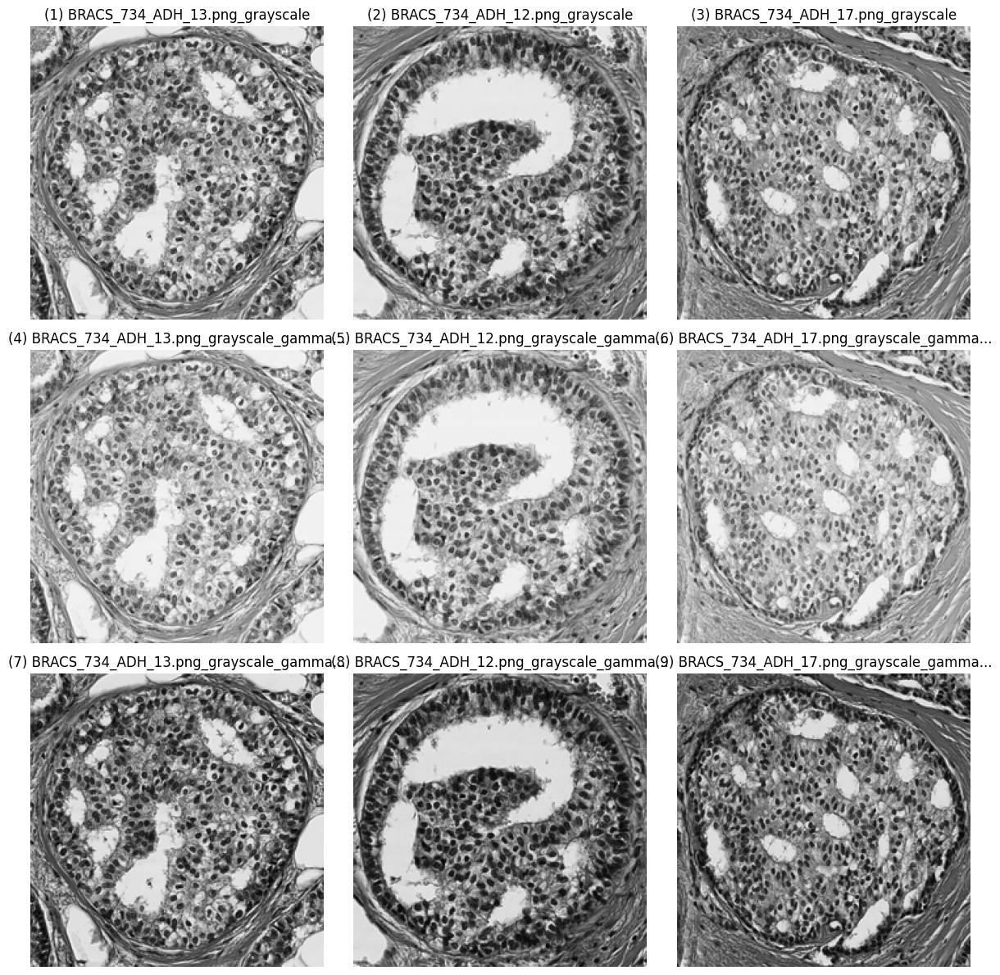

In [8]:
plot_images(amostras)

In [4]:
amostras = {}

#amostras.update(amostras_processor.get_images())
#amostras_processor.reset_images()


amostras_processor.light_intensity_shift(30)
amostras.update(amostras_processor.get_images())
amostras_processor.reset_images()

amostras_processor.light_intensity_change(1.2)
amostras.update(amostras_processor.get_images())
amostras_processor.reset_images()

amostras_processor.light_intensity_change_and_shift(1.2, 30)
amostras.update(amostras_processor.get_images())
amostras_processor.reset_images()

ValueError: Images of type float must be between -1 and 1.

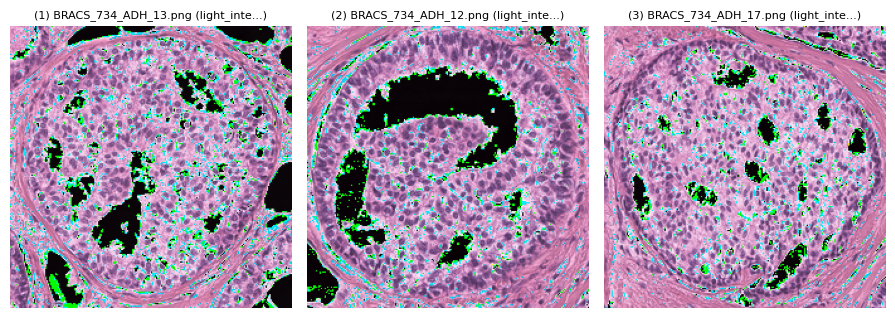

In [4]:
amostras_processor.light_intensity_shift(29)
amostras_processor.show_sample_images()
amostras_processor.reset_images()

In [6]:
amostras

{'BRACS_734_ADH_13.png_light_intensity_shift_o1_30': array([[[203, 161, 228],
         [214, 174, 234],
         [210, 172, 235],
         ...,
         [128,  78, 115],
         [169, 118, 181],
         [181, 125, 199]],
 
        [[208, 165, 235],
         [225, 185, 245],
         [222, 179, 239],
         ...,
         [113,  69,  98],
         [161, 109, 170],
         [204, 151, 227]],
 
        [[207, 160, 226],
         [190, 143, 210],
         [159, 109, 178],
         ...,
         [134,  84, 129],
         [176, 119, 184],
         [216, 169, 229]],
 
        ...,
 
        [[220, 183, 236],
         [217, 185, 226],
         [  7, 251,  17],
         ...,
         [ 10,   7,  13],
         [ 10,   7,  13],
         [ 11,   8,  12]],
 
        [[241, 211,   0],
         [236, 203, 248],
         [224, 192, 218],
         ...,
         [ 11,   7,  12],
         [ 11,   7,  12],
         [ 11,   7,  12]],
 
        [[235, 199, 251],
         [203, 166, 218],
         [168, 1

In [7]:
plot_images(amostras)

NameError: name 'plot_images' is not defined